In [1]:
using DifferentialEquations
include("src/Utils.jl")
include("src/Models.jl")
include("src/Params.jl");
using Plots; pythonplot();
using Statistics
using Contour
import Pandas as pd

## Add KaiBC-KaiA binding equilibrium to the model

In [2]:
"""
At low temperatures kSU can be different from kSUB. See Axmann et al. 2004 Fig. 4 and Gopal's preliminary data
"""
function kaiabc_phong_low_temp3!(dX, X, p, t)

    # U: unphosphorylated. T: only T432 phosphorylated. S: only S431 phosphorylated
    # D: doubly phosphorylated. DB: D KaiC bound with KaiB. SB: S KaiC bound with KaiB
    U, T, D, S, DB, SB = X

    # k's are reaction constants (here all are 1st-order), e.g., 
    # kTU is the per reactant rate transfering from T to U
    # kCIhyd: ATP hydrolysis rate of the CI ring
    # KA: [KaiA] that activates kinase activity to half maximum
    # A0: initial [KaiA]
    # fATP = [ATP] / ([ATP] + [ADP])
    # N: # A sequestered per D. M: # A sequestered per S
    kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU, kSUA, kUSA, kCIhyd,
    KA, A0, fATP, N, M, K_ASB = p

    hill(x) = x/(x + KA)

    # More realistic KaiA binding with a Kd
    # !!Ignored sequestration of KaiA by DB
    b = M*SB + A0 + K_ASB    # -b actually
    ASB = 1/(2M)*(b - sqrt(b^2 - 4M*SB*A0))
    A = A0 - M*ASB    # free KaiA

    #           U,      T,      D,      S,      DB,     SB
    dephos_r  = [0      kTU     0       kSU     0       kSU
                 0      0       kDT     0       kDT     0
                 0      0       0       0       0       0
                 0      0       kDS     0       0       0
                 0      0       0       0       0       0
                 0      0       0       0       kDS     0] +
                [0      kTUA    0       kSUA    0       kSUA
                 0      0       kDTA    0       kDTA    0
                 0      0       0       0       0       0
                 0      0       kDSA    0       0       0
                 0      0       0       0       0       0
                 0      0       0       0       kDSA    0]*hill(A)
    
    #         U     T       D       S       DB      SB
    phos_r = [0     0       0       0       0       0
              kUTA  0       0       0       0       0
              0     kTDA    0       kSDA    0       0
              kUSA  0       0       0       0       0
              0     0       0       0       0       kSDA
              0     0       0       0       0       0]*hill(A)*fATP

    #        U      T       D       S       DB      SB
    hyd_r = [0      0       0       0       0       0
             0      0       0       0       0       0
             0      0       0       0       0       0
             0      0       0       0       0       0
             0      0       kCIhyd  0       0       0
             0      0       0       kCIhyd  0       0]

    r = dephos_r + phos_r + hyd_r

    # conservation
    r -= I(size(r)[1]) .* sum(r, dims=1)

    # (for AD) Zygote.Buffer doesn't support in-place broadcast .=
    # see https://discourse.julialang.org/t/how-to-use-initialize-zygote-buffer/87653
    dX[:] = r*X
    nothing
end

kaiabc_phong_low_temp3!

Check out the trajectories

In [3]:
A0 = 1.0
fATP = 1.0

kSU_cold = 0.07
K_ASB = 0.002
M_new = 6


p_ori = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU, kSUA, kUSA, kCIhyd,
KA, A0, fATP, N, M);

p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
KA, A0, fATP, 0., M_new, K_ASB);

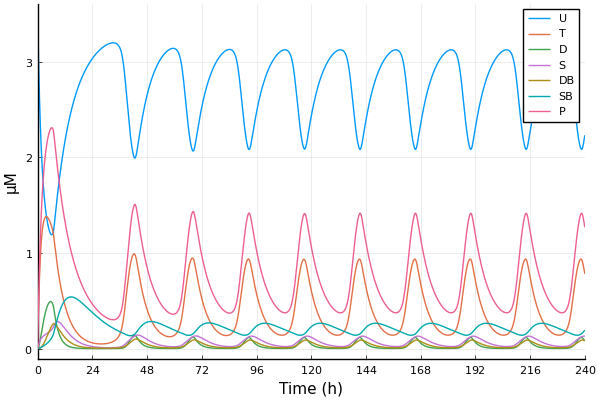

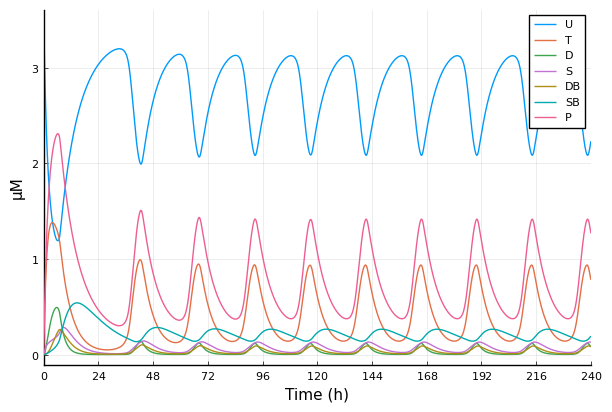

In [4]:
# U, T, D, S, DB, SB
p0 = [3.5, 0, 0, 0, 0, 0]

tmax = 240

prob = ODEProblem(kaiabc_phong_low_temp3!, p0, (0.0, tmax), p)
sol = solve(prob, Tsit5(), saveat = 0.1)

p = plot(sol, labels=["U" "T" "D" "S" "DB" "SB"])
plot!(sol.t, 3.5*phospho_C(sol.u), label="P")
xticks!(0:24:tmax)
xlabel!("Time (h)")
ylabel!("μM")
display(p)

In [5]:
A0 = 1.0
fATP = 1.0

kSU_cold = 0.07
K_ASB = 0.002
M_new = 6

p_ori = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU, kSUA, kUSA, kCIhyd,
KA, A0, fATP, N, M);

p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
KA, A0, fATP, 0., M_new, K_ASB);

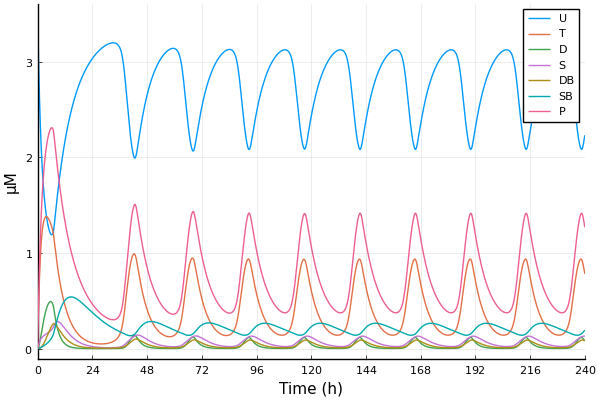

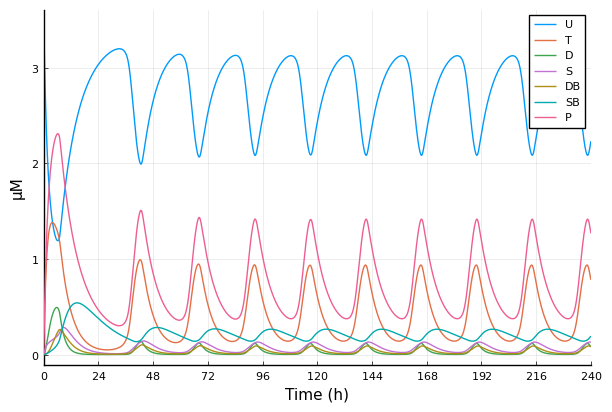

In [6]:
# U, T, D, S, DB, SB
p0 = [3.5, 0, 0, 0, 0, 0]

tmax = 240

prob = ODEProblem(kaiabc_phong_low_temp3!, p0, (0.0, tmax), p)
sol = solve(prob, Tsit5(), saveat = 0.1)

p = plot(sol, labels=["U" "T" "D" "S" "DB" "SB"])
plot!(sol.t, 3.5*phospho_C(sol.u), label="P")
xticks!(0:24:tmax)
xlabel!("Time (h)")
ylabel!("μM")
display(p)



$$
K_{ASB} = \frac{[\text{KaiA}]_{free}\cdot[\text{SB}]_{free}}{[(\text{KaiA})_M:\text{SB}]}
$$

Heatmap: checking out combinations of $k_{SU}$ and $K_{A:SB}$

In [14]:
kSU_vec = 0.005:0.0025:0.12
K_ASB_vec = 1e-4:2.5e-4:5e-3


# additional params
A0 = 1.0
fATP = 1.0

# KaiBC-KaiA binding stoichiometry
M_new = 6.

# find period numerically
per_mat = zeros(length(kSU_vec), length(K_ASB_vec))
amp_mat = zeros(length(kSU_vec), length(K_ASB_vec))
pC_mat = zeros(length(kSU_vec), length(K_ASB_vec))

for (i, kSU_cold) in enumerate(kSU_vec)
    for (j, K_ASB) in enumerate(K_ASB_vec)
        # initial conditions
        u0 = [3.5, 0, 0, 0, 0, 0]
        
        p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB)
        
        conv_t, amplitude, per, phase = 
            attracted_to(kaiabc_phong_low_temp3!, u0, 168, p; 
            burnin=96, conv_tol= 10, amp_cutoff=0.01, tmax_stop=1e3)

        per_mat[i, j] = per == -1 ? NaN : per
        amp_mat[i, j] = amplitude == -1 ? NaN : amplitude
        
        # solve it one more time to get mean fraction of pC
        prob = ODEProblem(kaiabc_phong_low_temp3!, u0, (0.0, conv_t + 1000.), p)
        sol = solve(prob, reltol=1e-8, abstol=1e-8)
        mean_pC = conv_t < 0 ? NaN : mean(phospho_C(sol.u[sol.t .> conv_t]))
        
        pC_mat[i, j] = mean_pC
        
        print("kSU=$(kSU_cold); K_SBA=$(K_ASB); amp=$(amplitude); per=$(per); pC=$(mean_pC)\n")
    end
end

kSU=0.005; K_SBA=0.0001; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00035; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0006; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00085; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0011; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00135; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0016; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00185; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0021; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00235; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0026; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00285; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0031; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00335; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0036; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00385; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0041; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00435; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.0046; amp=-1; per=-1; pC=NaN
kSU=0.005; K_SBA=0.00485; amp=-1; per=-1; pC=NaN
kSU=0.0075; K_SBA=0.0001; amp=

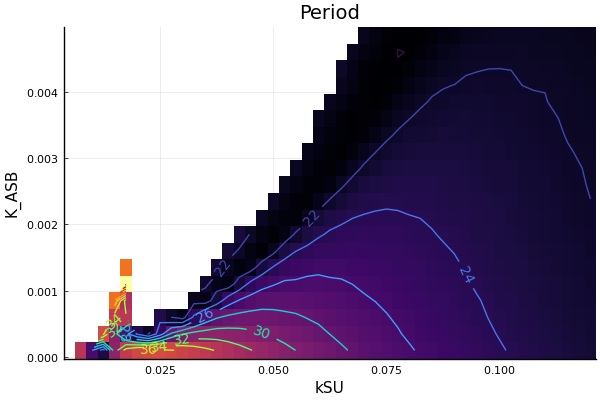

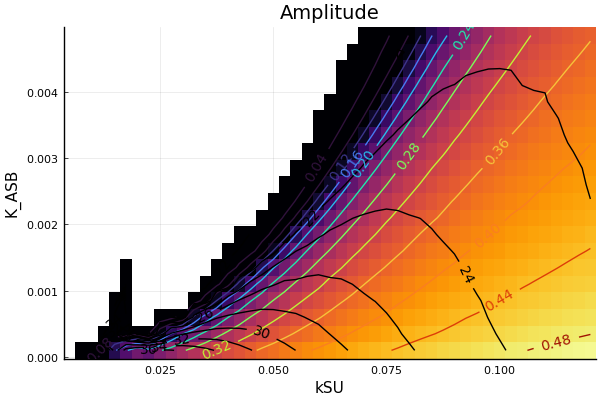

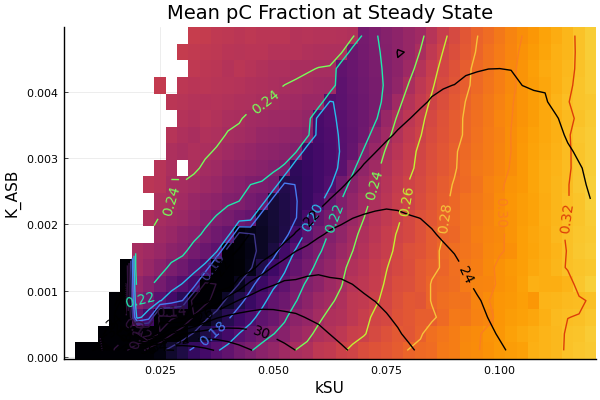

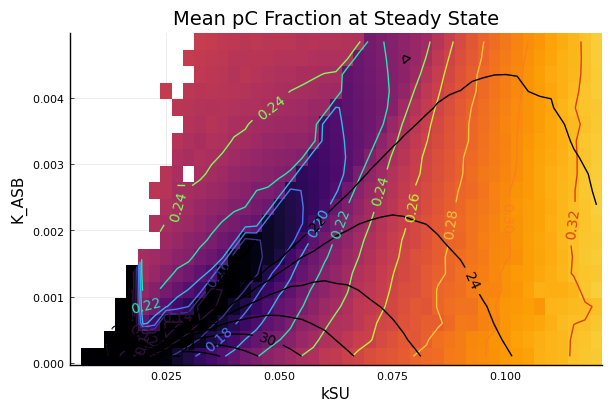

In [15]:
p1 = heatmap(kSU_vec, K_ASB_vec, transpose(per_mat), xlabel="kSU", ylabel="K_ASB", title = "Period")

contour!(p1, ones(length(K_ASB_vec))*kSU_vec',
    K_ASB_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false, lw=1)

display(p1)

p2 = heatmap(kSU_vec, K_ASB_vec, transpose(amp_mat), xlabel="kSU", ylabel="K_ASB", title = "Amplitude")

contour!(ones(length(K_ASB_vec))*kSU_vec',
    K_ASB_vec*ones(length(kSU_vec))', 
    transpose(amp_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false,
    lw=1, clims=(0.1, 0.5))

contour!(p2, ones(length(K_ASB_vec))*kSU_vec',
    K_ASB_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, clabels=true, color=[:black], lw=1)

display(p2)

p3 = heatmap(kSU_vec, K_ASB_vec, transpose(pC_mat), xlabel="kSU", ylabel="K_ASB", title = "Mean pC Fraction at Steady State")

contour!(ones(length(K_ASB_vec))*kSU_vec',
    K_ASB_vec*ones(length(kSU_vec))', 
    transpose(pC_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false, 
    lw=1, clims=(0.15, 0.35))

contour!(p3, ones(length(K_ASB_vec))*kSU_vec',
    K_ASB_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, clabels=true, color=[:black], lw=1)


display(p3)

Extract controur coordinates

In [16]:
using Contour

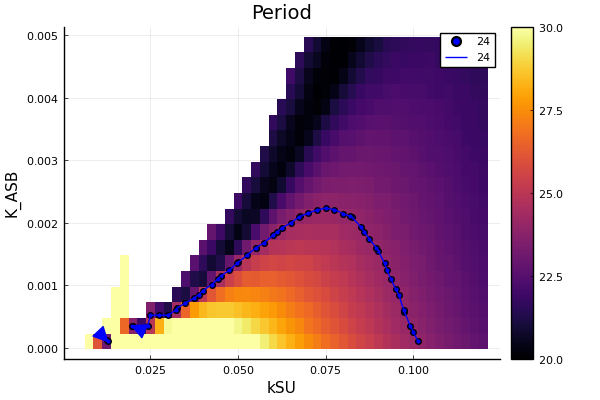

sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


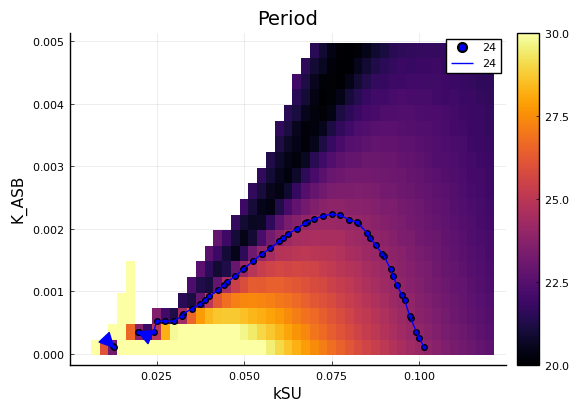

In [29]:
p4 = plot()
heatmap!(p4, kSU_vec, K_ASB_vec, transpose(per_mat), xlabel="kSU", ylabel="K_ASB", title = "Period", clim = (20,30))

cls = levels(contours(kSU_vec, K_ASB_vec, per_mat, [24]))
isochrone = Dict()
cl = cls[1]
line = lines(cl)[1]

lvl = level(cl) # the z-value of this contour level
isochrone[lvl] = []

xs, ys = coordinates(line) # coordinates of this line segment

isochrone[lvl] = [isochrone[lvl]..., (xs, ys)]
scatter!(p4, xs, ys, label="$(lvl)", c=:blue) # pseuod-code; use whatever plotting package you prefer
plot!(p4, xs, ys, arrow=(:closed, 1.), label="$(lvl)", c=:blue)

display(p4)

In [30]:
# master parameters
M_new = 6.

# constants
tmax = 480
istart = 3001

p1 = plot(legend=false)
#p2 = plot(legendtitle="M")

kSU_24 = isochrone[24][1][1]
K_ASB_24 = isochrone[24][1][2]

pal = palette(cgrad([:orange, :blue]), length(kSU_24))

for i in 1:2:length(kSU_24)
    
    if isnan(kSU_24[i]) || isnan(K_ASB_24[i])
        continue
    end
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB_24[i])

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    #pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end],c=pal[i])
    #plot!(p2, sol.t, hcat(sol.u...)[6, :], label="$(M_new)")
    
end

In [31]:
isochrone[24][1][2]

65-element Vector{Float64}:
   0.0001
   0.0002553399125430206
   0.00035
   0.0005724526959064579
   0.0006
   0.00085
   0.0009398957195925085
   0.0011
   0.0012356375441591966
   0.00135
   0.0015540595164368004
   0.0016
   0.0017381151788645284
   ⋮
   0.0011
   0.00135
 NaN
   0.00135
   0.0011
 NaN
   0.00085
   0.0006
 NaN
   0.00035
   0.00011643497287299715
   0.0001

In [32]:
# master parameters
M_new = 6.

# constants
tmax = 480
istart = 3001

p1 = plot(legend=false)
#p2 = plot(legendtitle="M")

kSU_24 = isochrone[24][1][1]
K_ASB_24 = isochrone[24][1][2]

pal = palette(cgrad([:orange, :blue]), length(kSU_24))

# find period numerically
per_mat_after = zeros(length(kSU_24), 1)
amp_mat_after = zeros(length(kSU_24), 1)
pC_mat_after = zeros(length(kSU_24), 1)

for i in 1:length(kSU_24)
    if isnan(kSU_24[i]) || isnan(K_ASB_24[i])
        break
    end
        
        # initial conditions
        u0 = [3.5, 0, 0, 0, 0, 0]
        
        p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB_24[i])
        
        conv_t, amplitude, per, phase = 
            attracted_to(kaiabc_phong_low_temp3!, u0, 168, p; 
            burnin=96, conv_tol=10, amp_cutoff=5e-5, tmax_stop=1e3)

        per_mat_after[i, 1] = per == -1 ? NaN : per
        amp_mat_after[i, 1] = amplitude == -1 ? NaN : amplitude
        
        # solve it one more time to get mean fraction of pC
        prob = ODEProblem(kaiabc_phong_low_temp3!, u0, (0.0, conv_t + 1000.), p)
        sol = solve(prob, reltol=1e-8, abstol=1e-8)
        mean_pC = conv_t < 0 ? NaN : mean(phospho_C(sol.u[sol.t .> conv_t]))
        
        pC_mat_after[i, 1] = mean_pC
        
        print("kSU=$(kSU_24[i]); K_ASB=$(K_ASB_24[i]); amp=$(amplitude); per=$(per); pC=$(mean_pC)\n")
end

kSU=0.1013670925776211; K_ASB=0.0001; amp=0.475762280538921; per=23.993901519346895; pC=0.30731684765482736
kSU=0.1; K_ASB=0.0002553399125430206; amp=0.46556019247466196; per=23.99683441940708; pC=0.30569724322754427
kSU=0.09915630272054203; K_ASB=0.00035; amp=0.4592261713641134; per=24.013774981324467; pC=0.3050251452462196
kSU=0.0975; K_ASB=0.0005724526959064579; amp=0.4469721006210646; per=24.009437802664078; pC=0.2984535282140636
kSU=0.09730212779175665; K_ASB=0.0006; amp=0.4460747400557895; per=24.005015429301203; pC=0.29663370977119574
kSU=0.0958421743336988; K_ASB=0.00085; amp=0.43339157288522506; per=23.967310787371435; pC=0.2971284073814401
kSU=0.095; K_ASB=0.0009398957195925085; amp=0.42851289801269055; per=23.990157132533636; pC=0.29331732806803273
kSU=0.09361872990625537; K_ASB=0.0011; amp=0.4205540968743648; per=24.005185282126618; pC=0.2945047882101909
kSU=0.0925; K_ASB=0.0012356375441591966; amp=0.41282483002288844; per=24.012335496966895; pC=0.2920256918414012
kSU=0.091

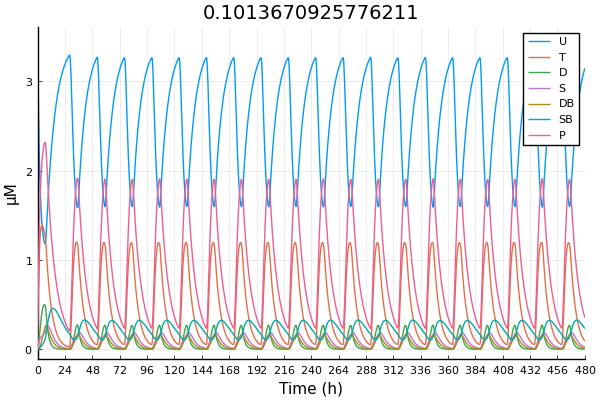

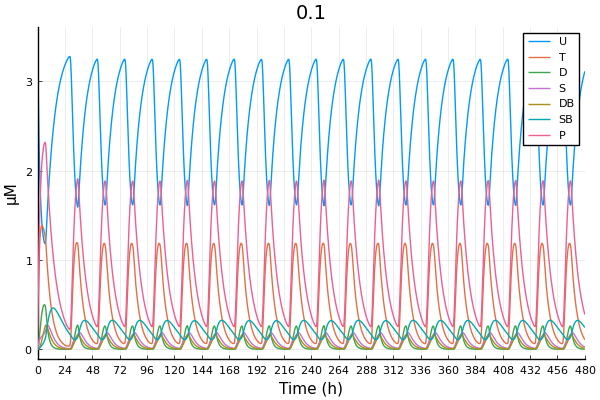

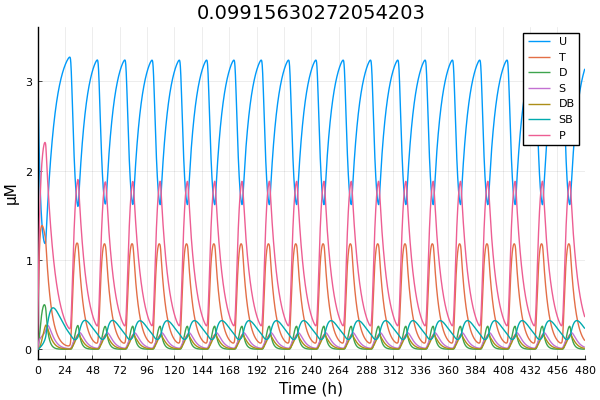

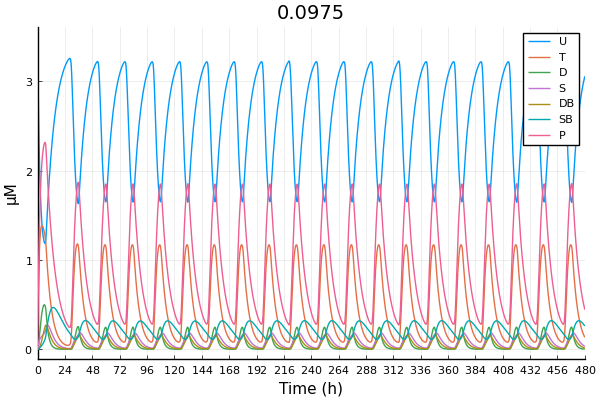

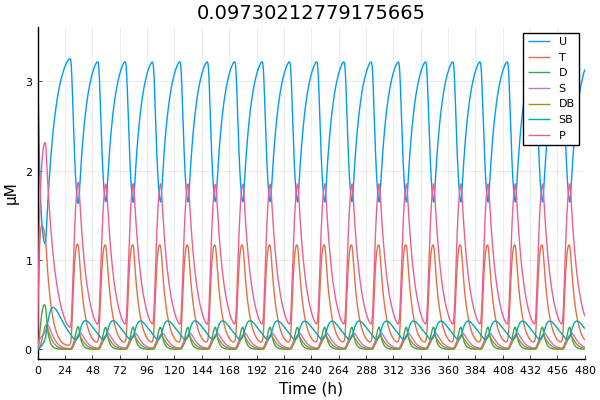

...

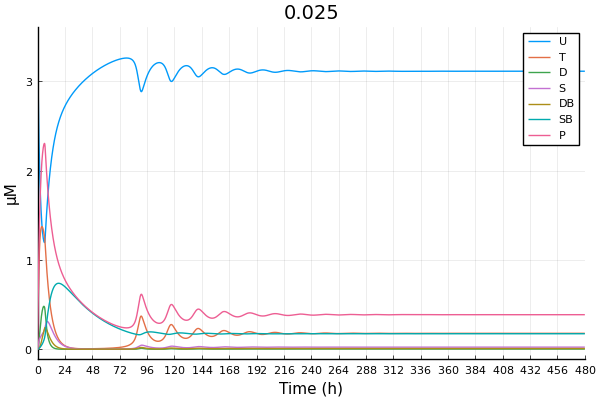

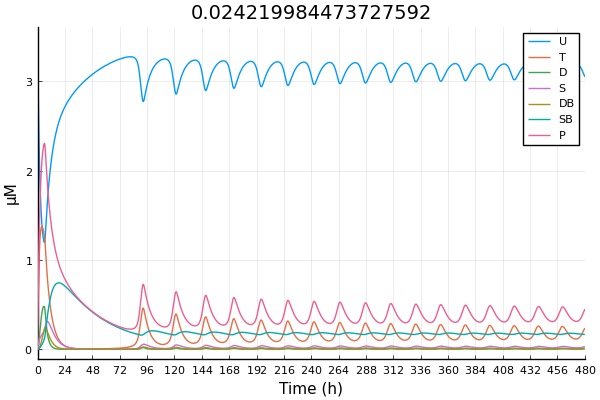

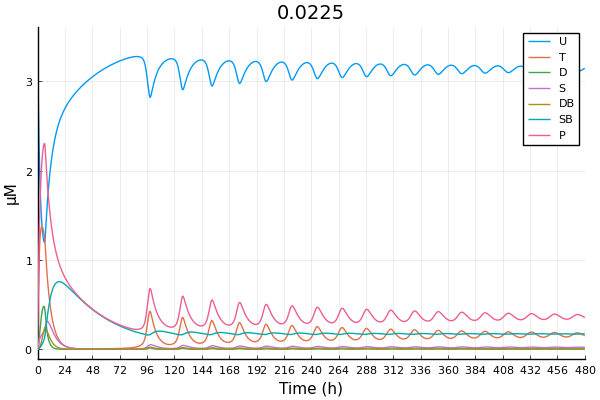

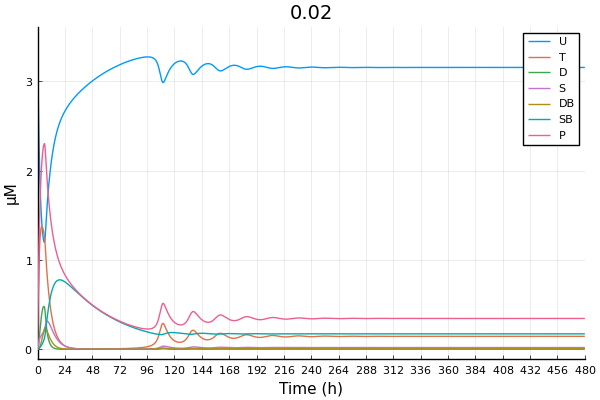

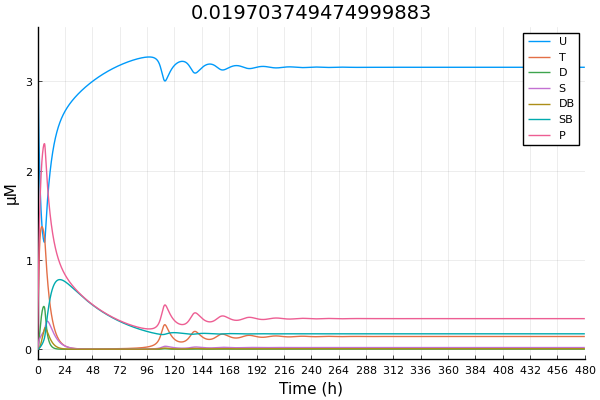

LoadError: UndefRefError: access to undefined reference

In [86]:
# Make traces for each of the pairs of parameters along the contour
plots = Array{Any}(undef,length(kSU_24), 1)

for i in 1:length(kSU_24)
    if isnan(kSU_24[i]) || isnan(K_ASB_24[i])
        continue
    end
    
    # U, T, D, S, DB, SB
    p0 = [3.5, 0, 0, 0, 0, 0]
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB_24[i])

    tmax = 480

    prob = ODEProblem(kaiabc_phong_low_temp3!, p0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    p_i = plot(title= kSU_24[i], sol, labels=["U" "T" "D" "S" "DB" "SB"])
    plot!(sol.t, 3.5*phospho_C(sol.u), label="P")
    xticks!(0:24:tmax)
    xlabel!("Time (h)")
    ylabel!("μM")

    plots[i, 1] = p_i
end

for plot in plots
    display(plot)
end

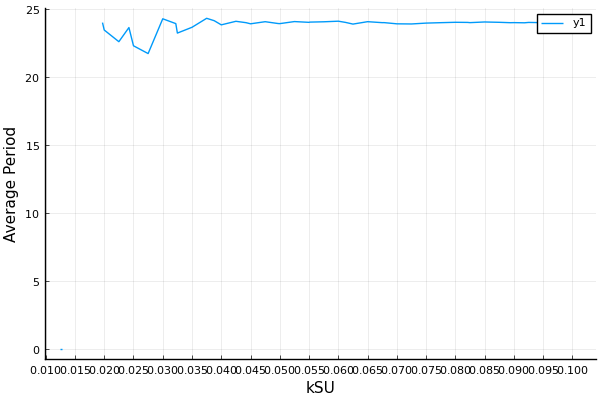

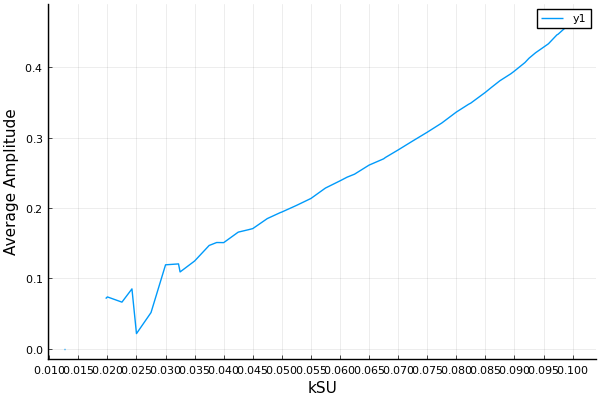

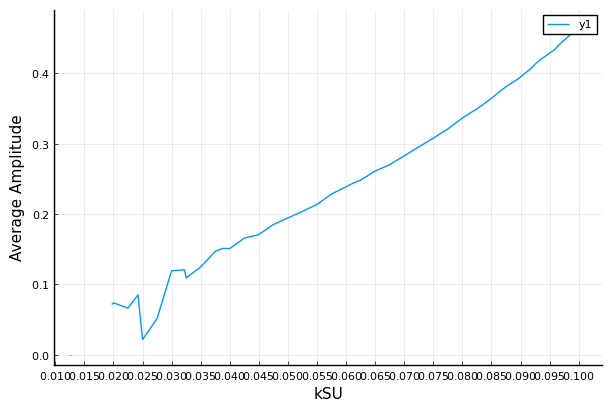

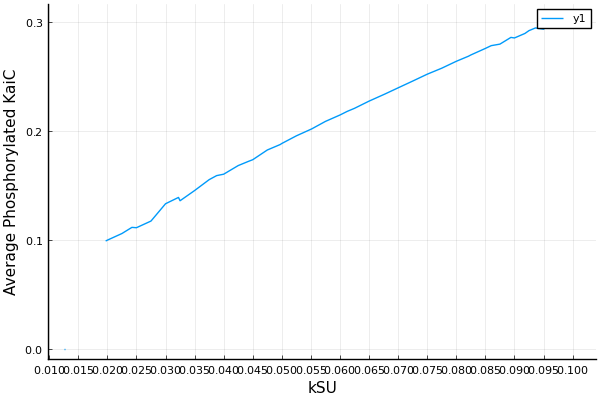

In [34]:
# Plots of average period, ampltiude and pC state over kSU
filtered_kSU_24 = filter(!isnan, kSU_24)

p_mean_per = plot(kSU_24, per_mat_after)
xticks!(0.0:0.005:maximum(filtered_kSU_24))
xlabel!("kSU")
ylabel!("Average Period")
display(p_mean_per)

p_mean_amp = plot(kSU_24, amp_mat_after)
xticks!(0.0:0.005:maximum(filtered_kSU_24))
xlabel!("kSU")
ylabel!("Average Amplitude")
display(p_mean_amp)

p_mean_pC = plot(kSU_24, pC_mat_after)
xticks!(0.0:0.005:maximum(filtered_kSU_24))
xlabel!("kSU")
ylabel!("Average Phosphorylated KaiC")

In [ ]:
# Plotting the contour again to show what point along the contour is what point along the average per, amp, and phos-KaiC curves
p5 = plot()
heatmap!(p5, kSU_vec, K_ASB_vec, transpose(per_mat), xlabel="kSU", ylabel="K_ASB", title = "Period")

cls = levels(contours(kSU_vec, K_ASB_vec, per_mat, [24]))
isochrone = Dict()
cl = cls[1]
line = lines(cl)[1]

lvl = level(cl) # the z-value of this contour level
isochrone[lvl] = []

xs, ys = coordinates(line) # coordinates of this line segment
isochrone[lvl] = [isochrone[lvl]..., (xs, ys)]
scatter!(p5, xs, ys, label="$(lvl)", c=:blue) # pseuod-code; use whatever plotting package you prefer
plot!(p5, xs, ys, arrow=(:closed, 1.), label="$(lvl)", c=:blue)

# Add a single point using marker formatted as desired:
pt = (isochrone[24][1][1][5],isochrone[24][1][2][5]) #where to place the marker

plot!(p5, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:red, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)

pt = (isochrone[24][1][1][9],isochrone[24][1][2][9]) #where to place the marker

plot!(p5, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:blue, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)
display(p5)

In [81]:
using Pkg
Pkg.add("DataFrames")
Pkg.add("XLSX")
Pkg.add("CSV")

using DataFrames
using XLSX
using CSV

# Exporting data to excel
vec = filtered_kSU_24
df = DataFrame(Column=vec)
CSV.write("C:\\Users\\yoohy\\Downloads\\kSU_24.csv", df)

println(typeof(per_mat_after))

vec = Base.vec(per_mat_after)  # Explicitly call Base.vec
df = DataFrame(Column=vec)
CSV.write("C:\\Users\\yoohy\\Downloads\\per_mat_after.csv", df)

vec = Base.vec(amp_mat_after)
df = DataFrame(Column=vec)
CSV.write("C:\\Users\\yoohy\\Downloads\\amp_mat_after.csv", df)

vec = Base.vec(pC_mat_after)
df = DataFrame(Column=vec)
CSV.write("C:\\Users\\yoohy\\Downloads\\pC_mat_after.csv", df)

Matrix{Float64}


"C:\\Users\\yoohy\\Downloads\\pC_mat_after.csv"

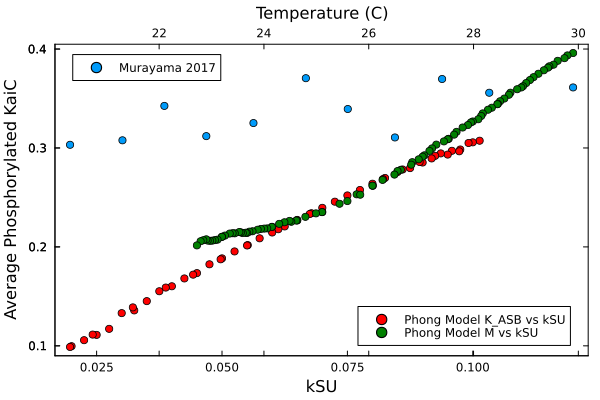

In [129]:
using Plots
using DataFrames
using CSV

# Read the data
data = CSV.read("C:\\Users\\yoohy\\Downloads\\murayama_data_pC.csv", DataFrame)
data_2 = CSV.read("C:\\Users\\yoohy\\Downloads\\kSU_24.csv", DataFrame)
data_3 = CSV.read("C:\\Users\\yoohy\\Downloads\\M_kSU_24.csv", DataFrame)

# Create the base plot with the first dataset
p = plot(data_2[!,1], data_2[!,2], 
         label = "Phong Model K_ASB vs kSU", 
         ylabel = "Average Phosphorylated KaiC", 
         color = :red, 
         legend = :bottomright, 
         grid = :off, 
         xlabel = "kSU", 
         seriestype = :scatter)

# Add the second dataset on the same plot
scatter!(p, data_3[!,1], data_3[!,2], 
         label = "Phong Model M vs kSU", 
         marker = :circle, 
         color = :green)

# Define the twiny function
function twiny(sp::Plots.Subplot)
    sp[:top_margin] = max(sp[:top_margin], 30*Plots.px)
    plot!(sp.plt, inset = (sp[:subplot_index], bbox(0,0,1,1)))
    twinsp = sp.plt.subplots[end]
    twinsp[:xaxis][:mirror] = true
    twinsp[:background_color_inside] = RGBA{Float64}(0,0,0,0)
    Plots.link_axes!(sp[:yaxis], twinsp[:yaxis])
    twinsp
end

twiny(plt::Plots.Plot = current()) = twiny(plt[1])

# Create a secondary x-axis and plot additional data
p_top = twiny(p)

# Plot additional data on the secondary x-axis
plot!(p_top, data[!,1], data[!,2], 
      label = "Murayama 2017", 
      legend = :topleft, 
      box = :on, 
      grid = :off, 
      xlabel = "Temperature (C)", 
      seriestype = :scatter)

# Display the plot
display(p)

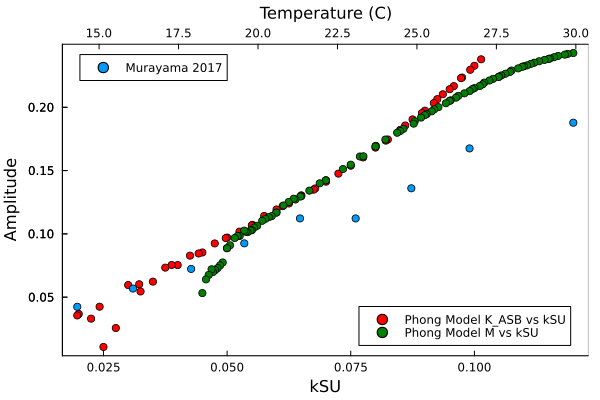

In [13]:
using Plots
using DataFrames
using CSV

# Read the data
data = CSV.read("data/murayama_experimental_amp.csv", DataFrame)
data_2 = CSV.read("data/kSU_24.csv", DataFrame)
data_3 = CSV.read("data/M_kSU_24.csv", DataFrame)

# Create the base plot with the first dataset
p = plot(data_2[!,1], data_2[!,5], 
         label = "Phong Model K_ASB vs kSU", 
         ylabel = "Amplitude", 
         color = :red, 
         legend = :bottomright, 
         grid = :off, 
         xlabel = "kSU", 
         seriestype = :scatter,
         fmt=:png)

# Add the second dataset on the same plot
scatter!(p, data_3[!,1], data_3[!,5], 
         label = "Phong Model M vs kSU", 
         marker = :circle, 
         color = :green)

# Define the twiny function
function twiny(sp::Plots.Subplot)
    sp[:top_margin] = max(sp[:top_margin], 30*Plots.px)
    plot!(sp.plt, inset = (sp[:subplot_index], bbox(0,0,1,1)))
    twinsp = sp.plt.subplots[end]
    twinsp[:xaxis][:mirror] = true
    twinsp[:background_color_inside] = RGBA{Float64}(0,0,0,0)
    Plots.link_axes!(sp[:yaxis], twinsp[:yaxis])
    twinsp
end

twiny(plt::Plots.Plot = current()) = twiny(plt[1])

# Create a secondary x-axis and plot additional data
p_top = twiny(p)

# Plot additional data on the secondary x-axis
plot!(p_top, data[!,1], data[!,2], 
      label = "Murayama 2017", 
      legend = :topleft, 
      framestyle=:semi, 
      framewidth=10,
      grid = :off, 
      xlabel = "Temperature (C)", 
      seriestype = :scatter)

# Display the plot
display(p)

In [18]:
# Plots of average period, ampltiude and pC state over K_ASB

#=filtered_K_ASB_24 = filter(!isnan, K_ASB_24)

p_mean_per = plot(K_ASB_24, per_mat_after)
xticks!(0.0:0.0005:maximum(filtered_K_ASB_24))
xlabel!("K_ASB")
ylabel!("Average Period")
display(p_mean_per)

p_mean_amp = plot(K_ASB_24, amp_mat_after)
xticks!(0.0:0.0005:maximum(filtered_K_ASB_24))
xlabel!("K_ASB")
ylabel!("Average Amplitude")
display(p_mean_amp)

p_mean_pC = plot(K_ASB_24, pC_mat_after)
xticks!(0.0:0.0005:maximum(filtered_K_ASB_24))
xlabel!("K_ASB")
ylabel!("Average Phosphorylated KaiC")=#

In [92]:
length(kSU_24)

65

51

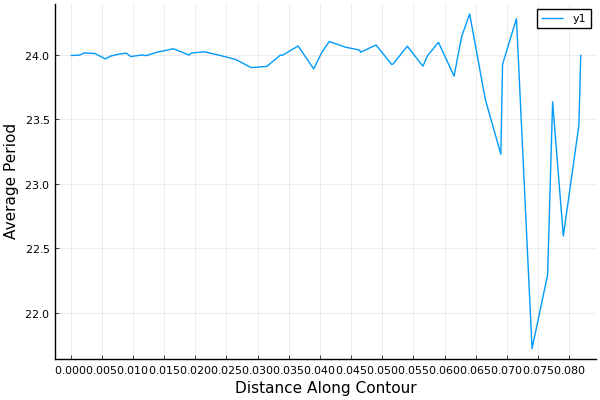

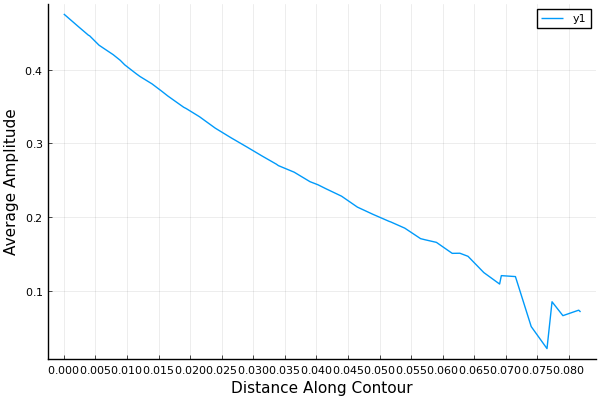

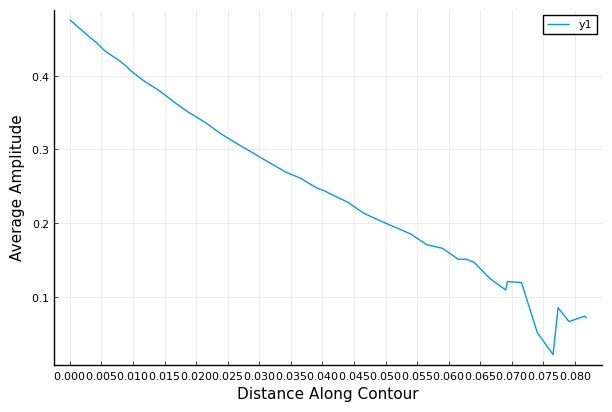

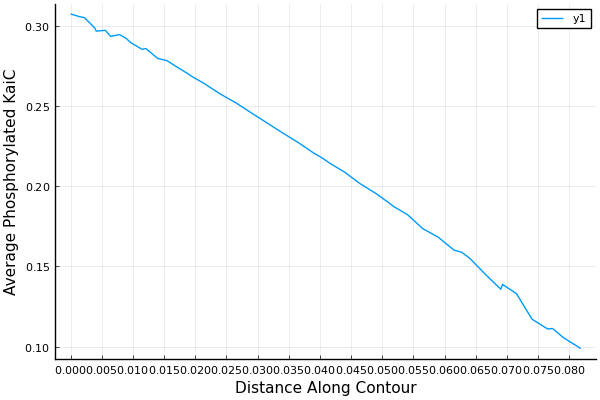

In [36]:
# Plots of average period, amplitude, and pC state over contour coordinates

# Find the length of the doubly filtered arrays
j = 0
for i in 1:length(kSU_24)
    if isnan(kSU_24[i]) || isnan(K_ASB_24[i])
        break
    else
        j+= 1
    end
end

doubly_filtered_length = j
print(doubly_filtered_length)

# Doubly filter the arrays
k = 1
doubly_filtered_kSU_24 = kSU_24[1:doubly_filtered_length]
doubly_filtered_K_ASB_24 = K_ASB_24[1:doubly_filtered_length]
cont_distances = zeros(doubly_filtered_length,1)

kSU_changes = doubly_filtered_kSU_24[2:end]-doubly_filtered_kSU_24[1:end-1]
K_ASB_changes = doubly_filtered_K_ASB_24[2:end]-doubly_filtered_K_ASB_24[1:end-1]
distances = @.sqrt(kSU_changes^2 + K_ASB_changes^2)

cont_distance = 0
for i in 1:doubly_filtered_length
    if i == 1
        cont_distance = 0
        cont_distances[i,1] = cont_distance
    else

        cont_distance += distances[i-1,1]
        cont_distances[i,1] = cont_distance
    end
end    

p_mean_per = plot(cont_distances, per_mat_after[1:doubly_filtered_length])
xticks!(0.0:0.005:maximum(cont_distances))
xlabel!("Distance Along Contour")
ylabel!("Average Period")
display(p_mean_per)

p_mean_amp = plot(cont_distances, amp_mat_after[1:doubly_filtered_length])
xticks!(0.0:0.005:maximum(cont_distances))
xlabel!("Distance Along Contour")
ylabel!("Average Amplitude")
display(p_mean_amp)

p_mean_pC = plot(cont_distances, pC_mat_after[1:doubly_filtered_length])
xticks!(0.0:0.005:maximum(cont_distances))
xlabel!("Distance Along Contour")
ylabel!("Average Phosphorylated KaiC")

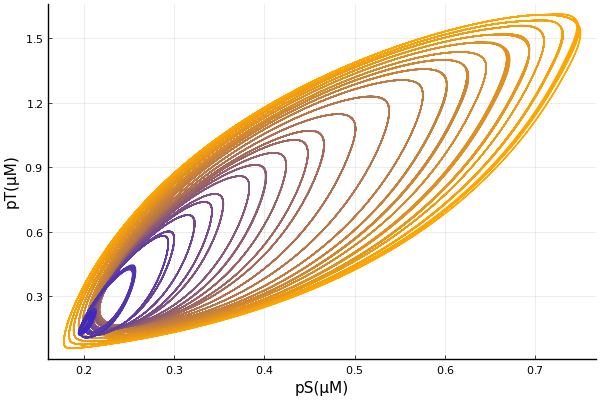

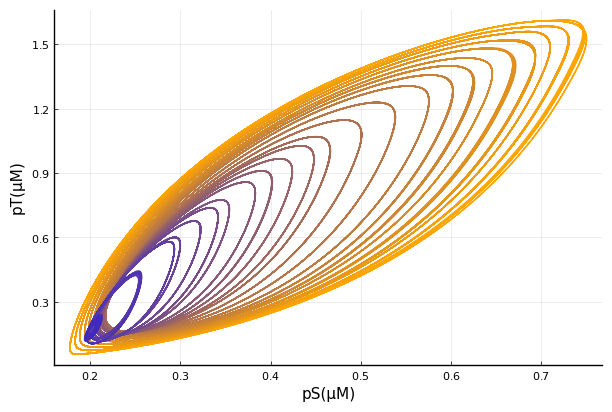

In [91]:
# master parameters
M_new = 6.

# constants
tmax = 480
istart = 3001

p1 = plot(legend=false)
#p2 = plot(legendtitle="M")

kSU_24 = isochrone[24][1][1]
K_ASB_24 = isochrone[24][1][2]

pal = palette(cgrad([:orange, :blue]), length(kSU_24))

for i in 1:2:length(kSU_24)
    
    if isnan(kSU_24[i]) || isnan(K_ASB_24[i])
        break
    end
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB_24[i])

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    #pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end],c=pal[i])
    #plot!(p2, sol.t, hcat(sol.u...)[6, :], label="$(M_new)")
    
end

xlabel!(p1, "pS(μM)")
ylabel!(p1, "pT(μM)")
display(p1)

## Exploring stoichiometry

In [73]:
function solve_SBA(Atot; M = 6., Kd = 1e-3, SB = 3.5)
    Delta = (M*SB + Atot + Kd)^2 - 4M*Atot*SB
    SBA = 1/(2M)*(M*SB + Atot + Kd - sqrt(Delta))
    return SBA
end

solve_SBA (generic function with 1 method)

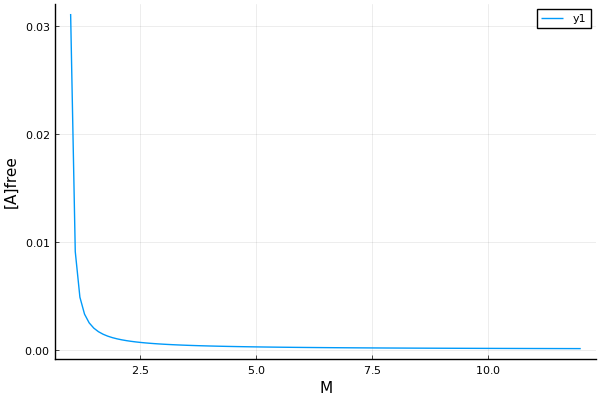

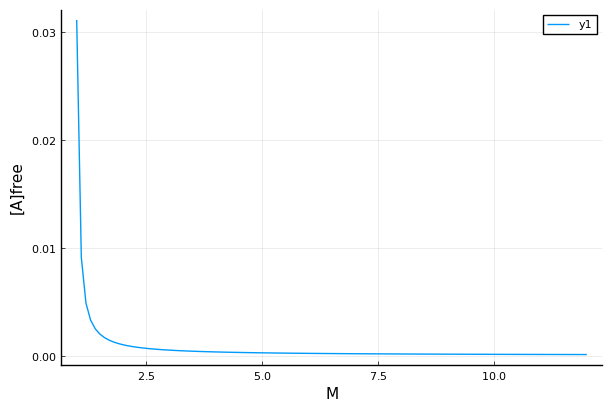

In [80]:
M_vec = 1:0.1:12.
Atot = 1.0

p1 = plot(M_vec, (m -> Atot - m*solve_SBA(Atot; M = m, SB = 1.)).(M_vec))
xlabel!("M")
ylabel!("[A]free")
display(p1)

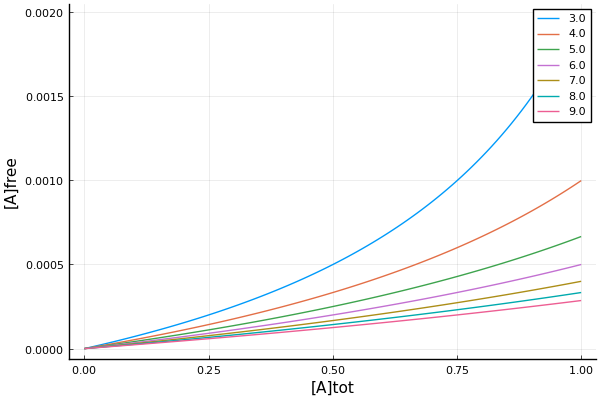

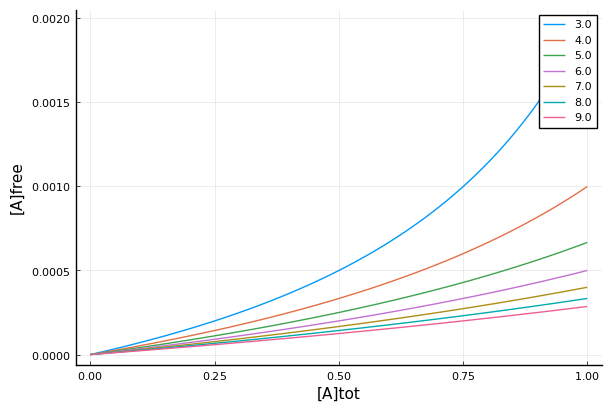

In [77]:
Atot_vec = 0:0.01:1.

M_vec = 3.:1.:9.

p1 = plot()
for M in M_vec
    plot!(Atot_vec, Atot_vec .- M*solve_SBA.(Atot_vec; M = M, SB = 0.5, Kd = 1e-3), label="$(M)")
end
xlabel!("[A]tot")
ylabel!("[A]free")

display(p1)

Experimentally we've shown that the $S \rightarrow U$ reaction is inhibited at low temperatures while $D \rightarrow S$ less so,
which hints accumulation of S species at low temperatures.
Since SB complex sequesters KaiA which is strictly required to phosphorylate KaiC, the accumulation of S is expected to delay KaiC phosphorylation which, overall, lengthens the period.

However, in terms of phenomenology we know that the period is compensated with varying temperatures.
There has to be one or more temperature dependent reactions that balance the period-lengthening effect of the slowed down
$S \rightarrow U$ step.


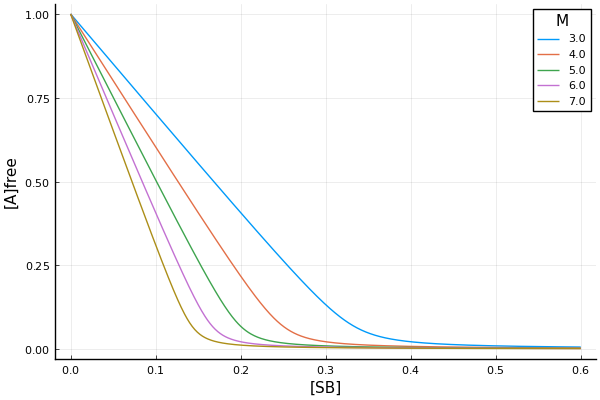

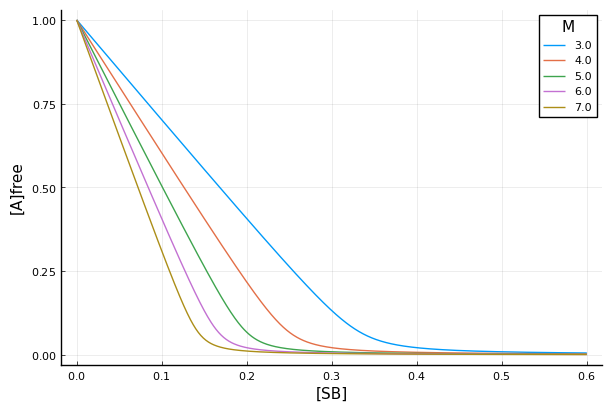

In [225]:
SB_vec = 0:0.001:0.6
Atot = 1.

M_vec = 3.:1.:7.

# p = plot(legendtitle = "M", xlim=(0.1, 0.65))
p = plot(legendtitle = "M")
for M in M_vec
    plot!(SB_vec, Atot .- M*(sb -> solve_SBA(Atot; M = M, SB = sb, Kd = 0.005)).(SB_vec), label="$(M)")
end
xlabel!("[SB]")
ylabel!("[A]free")

display(p)

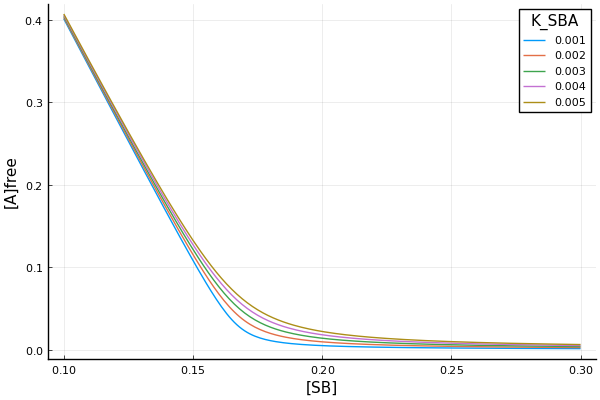

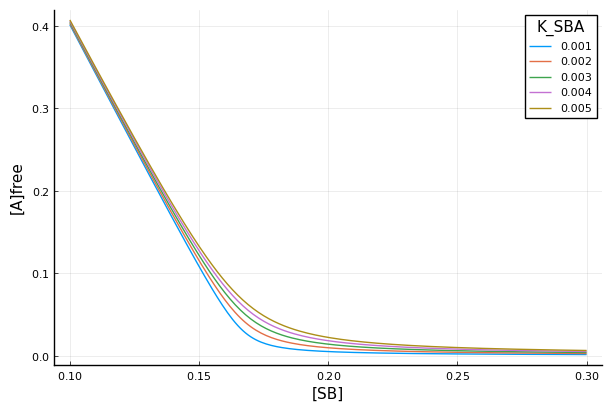

In [227]:
SB_vec = 0.1:0.001:0.3
Atot = 1.

K_SBA_vec = 1e-3:1e-3:5e-3
# K_SBA_vec = 4e-4:2e-4:1.2e-3

p = plot(legendtitle = "K_SBA")
# p = plot(legendtitle = "K_SBA", xlim=(0.12, 0.3))
for K_SBA in K_SBA_vec
    plot!(SB_vec, Atot .- M*(sb -> solve_SBA(Atot; M = 6., SB = sb, Kd = K_SBA)).(SB_vec), label="$(K_SBA)")
end
xlabel!("[SB]")
ylabel!("[A]free")

display(p)

The Murayama 2017 paper shows that as temperature decreases, though the amplitude also decreases, the mean phosphorylation level is largely unaffected (from $30^\circ C$ all the way to 16. Phosphorylation level goes up at 10).

Is it true in the model either with varying $M$ or varying $K_{SBA}$?

In [81]:
kSU_vec = 0.02:0.004:0.12
M_vec = 2.:0.3:8.

# additional params
A0 = 1.0
fATP = 1.0

# KaiBC-KaiA binding stoichiometry
K_SBA = 0.002

# find period numerically
per_mat = zeros(length(kSU_vec), length(M_vec))
amp_mat = zeros(length(kSU_vec), length(M_vec))
pC_mat = zeros(length(kSU_vec), length(M_vec))

for (i, kSU_cold) in enumerate(kSU_vec)
    for (j, M_new) in enumerate(M_vec)
        # initial conditions
        u0 = [3.5, 0, 0, 0, 0, 0]
        
        p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_SBA)
        
        conv_t, amplitude, per, phase = 
        attracted_to(kaiabc_phong_low_temp3!, u0, 168, p; 
        burnin=96, conv_tol=5e-2, amp_cutoff=5e-2, tmax_stop=1e3)

        per_mat[i, j] = per == -1 ? NaN : per
        amp_mat[i, j] = amplitude == -1 ? NaN : amplitude
        
        # solve it one more time to get mean fraction of pC
        prob = ODEProblem(kaiabc_phong_low_temp3!, u0, (0.0, conv_t + 1000.), p)
        sol = solve(prob, reltol=1e-8, abstol=1e-8)
        mean_pC = conv_t < 0 ? NaN : mean(phospho_C(sol.u[sol.t .> conv_t]))
        
        pC_mat[i, j] = mean_pC
        
        print("kSU=$(kSU_cold); M=$(M_new); amp=$(amplitude); per=$(per); pC=$(mean_pC)\n")
    end
end

kSU=0.02; M=2.0; amp=-1; per=-1; pC=NaN
kSU=0.02; M=2.3; amp=-1; per=-1; pC=0.3263812047288559
kSU=0.02; M=2.6; amp=-1; per=-1; pC=0.3168841724331472
kSU=0.02; M=2.9; amp=-1; per=-1; pC=0.3080035223606055
kSU=0.02; M=3.2; amp=-1; per=-1; pC=0.2998405669748937
kSU=0.02; M=3.5; amp=-1; per=-1; pC=0.29121670172891817
kSU=0.02; M=3.8; amp=-1; per=-1; pC=0.2810533261141835
kSU=0.02; M=4.1; amp=-1; per=-1; pC=0.278270082916181
kSU=0.02; M=4.4; amp=-1; per=-1; pC=0.27077070846834084
kSU=0.02; M=4.7; amp=-1; per=-1; pC=0.26052882018501067
kSU=0.02; M=5.0; amp=-1; per=-1; pC=0.25929828543726174
kSU=0.02; M=5.3; amp=-1; per=-1; pC=NaN
kSU=0.02; M=5.6; amp=-1; per=-1; pC=NaN
kSU=0.02; M=5.9; amp=-1; per=-1; pC=NaN
kSU=0.02; M=6.2; amp=-1; per=-1; pC=NaN
kSU=0.02; M=6.5; amp=-1; per=-1; pC=NaN
kSU=0.02; M=6.8; amp=-1; per=-1; pC=NaN
kSU=0.02; M=7.1; amp=-1; per=-1; pC=NaN
kSU=0.02; M=7.4; amp=-1; per=-1; pC=NaN
kSU=0.02; M=7.7; amp=-1; per=-1; pC=NaN
kSU=0.02; M=8.0; amp=-1; per=-1; pC=NaN
kSU=0.0

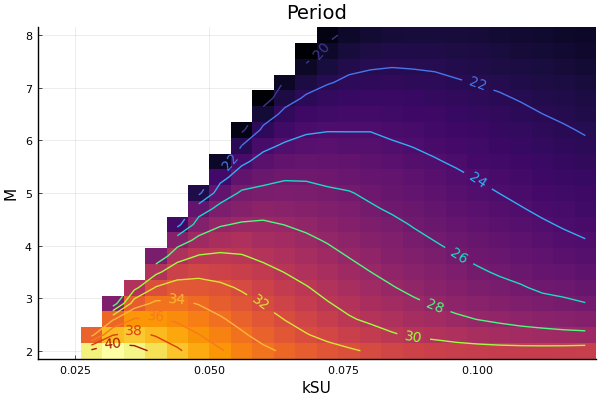

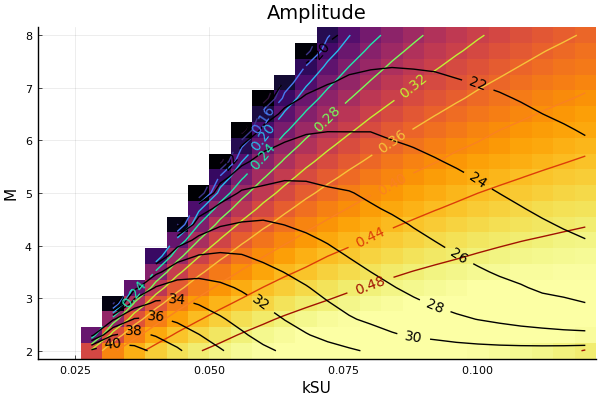

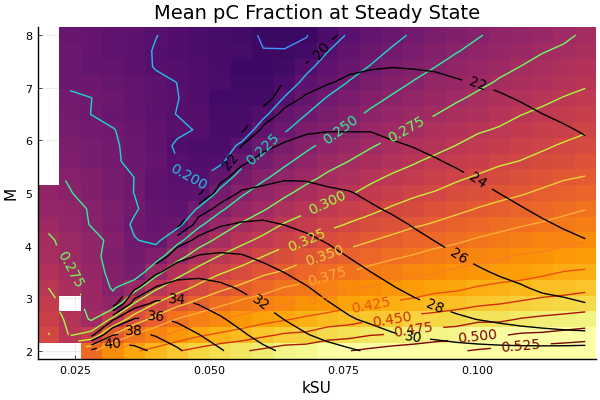

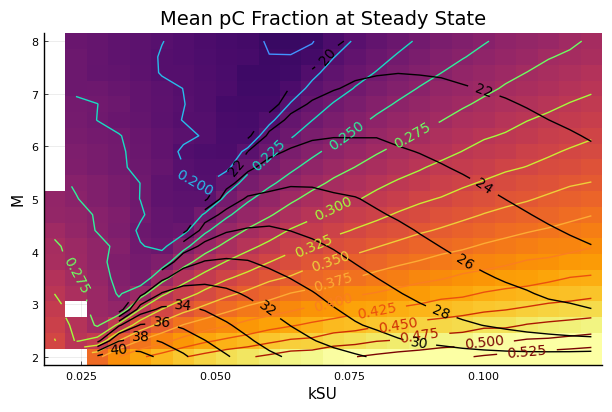

In [82]:
p1 = heatmap(kSU_vec, M_vec, transpose(per_mat), xlabel="kSU", ylabel="M", title = "Period")

contour!(p1, ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false, lw=1)

display(p1)

p2 = heatmap(kSU_vec, M_vec, transpose(amp_mat), xlabel="kSU", ylabel="M", title = "Amplitude")

contour!(ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(amp_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false,
    lw=1, clims=(0.1, 0.5))

contour!(p2, ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, clabels=true, color=[:black], lw=1)

display(p2)

p3 = heatmap(kSU_vec, M_vec, transpose(pC_mat), xlabel="kSU", ylabel="M", title = "Mean pC Fraction at Steady State")

contour!(ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(pC_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false, 
    lw=1, clims=(0.1, 0.5))

contour!(p3, ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, clabels=true, color=[:black], lw=1)


display(p3)

Extract contour coordinates

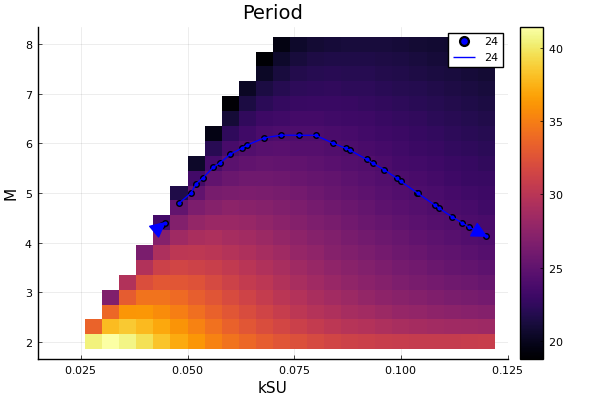

sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


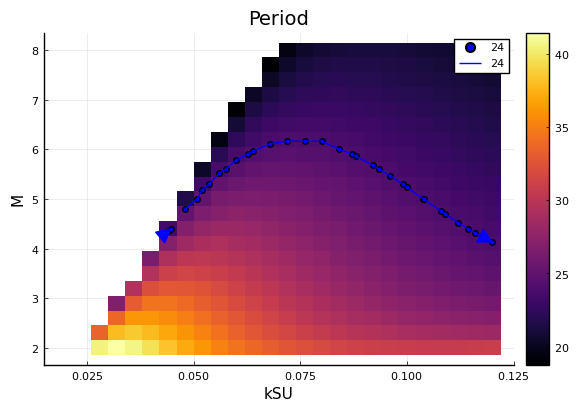

In [83]:
p4 = plot()
heatmap!(p4, kSU_vec, M_vec, transpose(per_mat), xlabel="kSU", ylabel="M", title = "Period")

cls = levels(contours(kSU_vec, M_vec, per_mat, [24]))
isochrone = Dict()
for cl in cls
    lvl = level(cl) # the z-value of this contour level
    isochrone[lvl] = []
    for line in lines(cl)
        xs, ys = coordinates(line) # coordinates of this line segment
        isochrone[lvl] = [isochrone[lvl]..., (xs, ys)]
        scatter!(p4, xs, ys, label="$(lvl)", c=:blue) # pseuod-code; use whatever plotting package you prefer
        plot!(p4, xs, ys, arrow=(:closed, 1.), label="$(lvl)", c=:blue)
    end
end

display(p4)

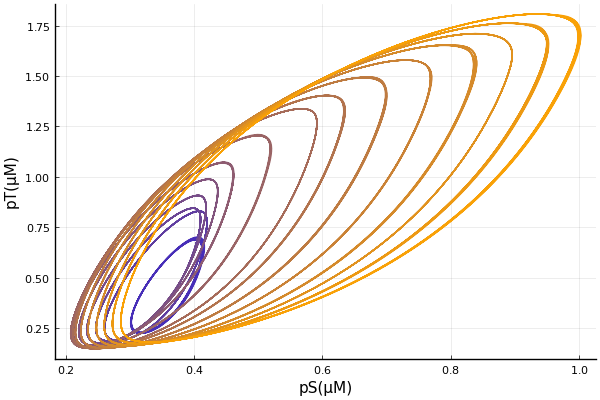

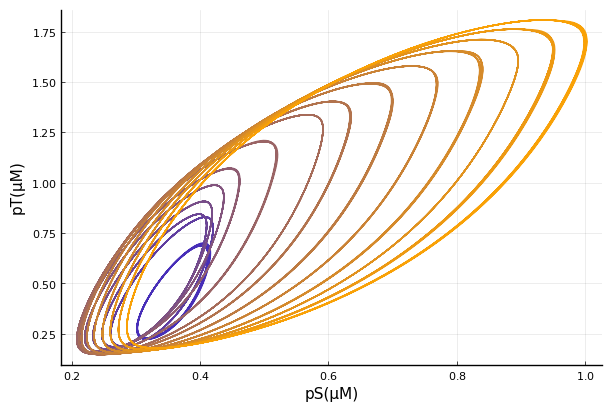

In [86]:
# master parameters
K_SBA = 0.002

# constants
tmax = 480
istart = 3001

p1 = plot(legend=false)

kSU_24 = isochrone[24][1][1]
M_24 = isochrone[24][1][2]

pal = palette(cgrad([:blue, :orange]), length(kSU_24))

for i in 1:2:length(kSU_24)
    
    if isnan(kSU_24[i]) || isnan(M_24[i])
        continue
    end
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_24[i], K_SBA)

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    #pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end],c=pal[i])
    
end

xlabel!(p1, "pS(μM)")
ylabel!(p1, "pT(μM)")
display(p1)


Limit cycle in the pS-pT space as M or Kd changes

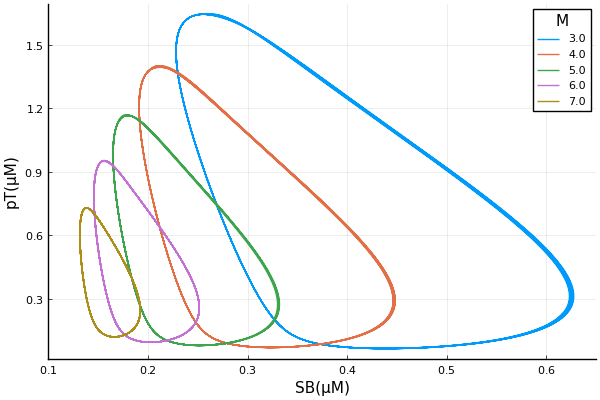

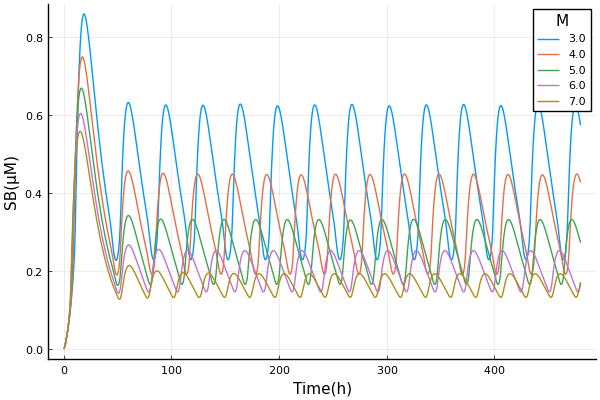

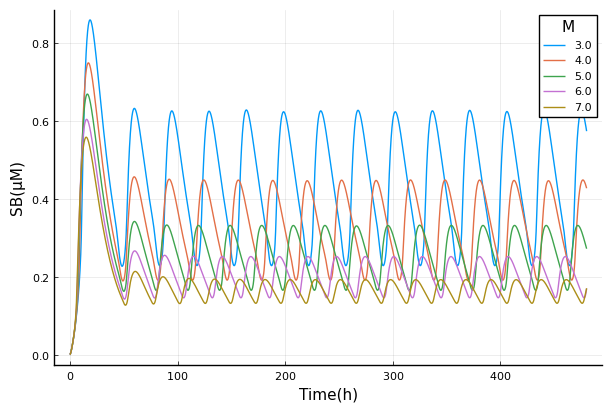

In [39]:
# master parameters
K_SBA = 0.001
M_new = 6.
kSU_new = 0.05

# Vary M
M_vec = 3.:1.:7.

# constants
tmax = 480
istart = 2001

p1 = plot(legendtitle="M", xlim=(0.1, 0.65))
p2 = plot(legendtitle="M")
for M_new in M_vec
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_new, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_SBA)

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    #pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end], label="$(M_new)")
    plot!(p2, sol.t, hcat(sol.u...)[6, :], label="$(M_new)")
    
end

xlabel!(p1, "SB(μM)")
ylabel!(p1, "pT(μM)")
display(p1)

xlabel!(p2, "Time(h)")
ylabel!(p2, "SB(μM)")
display(p2)

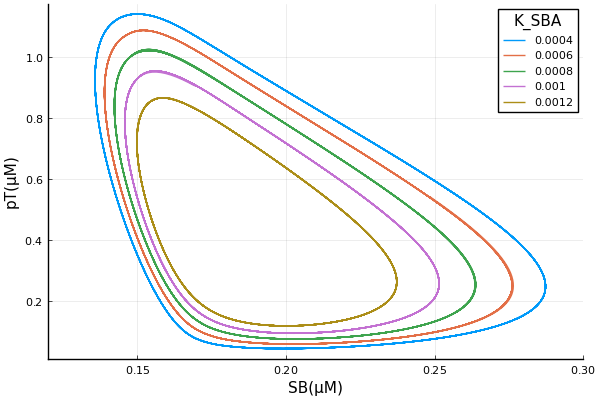

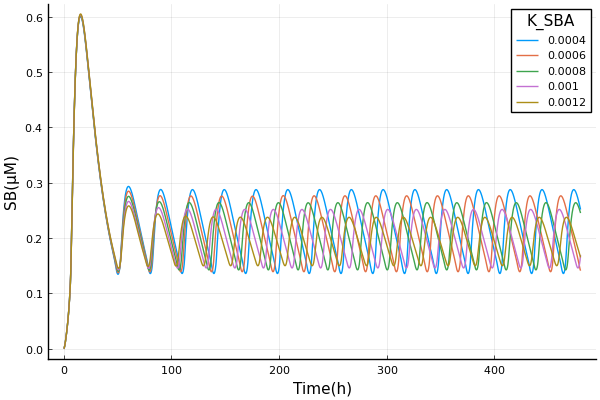

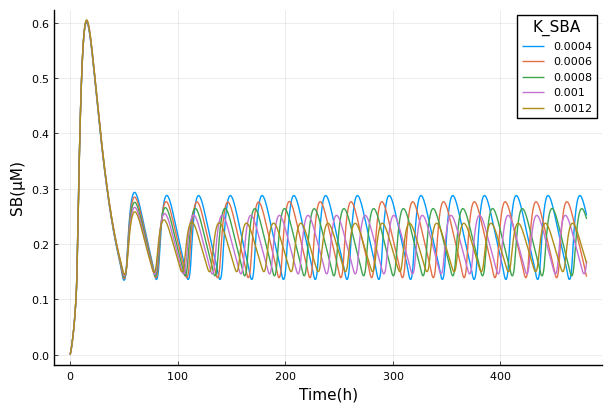

In [40]:
# master parameters
K_SBA = 0.001
M_new = 6.
kSU_new = 0.05

# Vary Kd
K_SBA_vec = 4e-4:2e-4:1.2e-3

# constants
tmax = 480
istart = 2001

p1 = plot(legendtitle="K_SBA", xlim=(0.12, 0.3))
p2 = plot(legendtitle="K_SBA")
for K_SBA in K_SBA_vec
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_new, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_SBA)

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    #pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end], label="$(K_SBA)")
    plot!(p2, sol.t, hcat(sol.u...)[6, :], label="$(K_SBA)")
    
end

xlabel!(p1, "SB(μM)")
ylabel!(p1, "pT(μM)")
display(p1)

xlabel!(p2, "Time(h)")
ylabel!(p2, "SB(μM)")
display(p2)

In [16]:
A0 = 1.0
fATP = 1.0

kSU_cold = 0.02
K_ASB = 0.0005
M_new = 2.


p_ori = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU, kSUA, kUSA, kCIhyd,
KA, A0, fATP, N, M);

p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
KA, A0, fATP, 0., M_new, K_ASB);